In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, OrdinalEncoder
from sklearn.model_selection import train_test_split
# import kagglehub
import shutil
import os
# Download latest version
# path = kagglehub.dataset_download("dinithpriyankara/research-dataset")

# print("Path to dataset files:", path)

# destination_path = "/content"
# if os.path.exists(path):
#     try:
#         shutil.copytree(path, destination_path + "/research-dataset", dirs_exist_ok = True)
#         print("Files copied successfully to:", destination_path + "/research-dataset")
#     except Exception as e:
#         print(f"Error copying files: {e}")
# else:
#     print(f"Source directory not found: {source_path}")

**Data Preparation**

In [2]:
url = "Steel_industry_data.csv"
df = pd.read_csv(url)
df.head()

,date,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Day_of_week,Load_Type
0,01/01/2018 00:15,3.17,2.95,0.0,0.0,73.21,100.0,900,Weekday,Monday,Light_Load
1,01/01/2018 00:30,4.00,4.46,0.0,0.0,66.77,100.0,1800,Weekday,Monday,Light_Load
2,01/01/2018 00:45,3.24,3.28,0.0,0.0,70.28,100.0,2700,Weekday,Monday,Light_Load
3,01/01/2018 01:00,3.31,3.56,0.0,0.0,68.09,100.0,3600,Weekday,Monday,Light_Load
4,01/01/2018 01:15,3.82,4.50,0.0,0.0,64.72,100.0,4500,Weekday,Monday,Light_Load


**Encoder**

In [3]:
encoder = OrdinalEncoder()
df[['WeekStatus', 'Load_Type']] = encoder.fit_transform(df[['WeekStatus', 'Load_Type']])


In [4]:
df.head()

,date,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Day_of_week,Load_Type
0,01/01/2018 00:15,3.17,2.95,0.0,0.0,73.21,100.0,900,0.0,Monday,0.0
1,01/01/2018 00:30,4.00,4.46,0.0,0.0,66.77,100.0,1800,0.0,Monday,0.0
2,01/01/2018 00:45,3.24,3.28,0.0,0.0,70.28,100.0,2700,0.0,Monday,0.0
3,01/01/2018 01:00,3.31,3.56,0.0,0.0,68.09,100.0,3600,0.0,Monday,0.0
4,01/01/2018 01:15,3.82,4.50,0.0,0.0,64.72,100.0,4500,0.0,Monday,0.0


In [5]:
df['date'] = pd.to_datetime(df['date'], dayfirst=True)

In [6]:
df.head()

,date,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Day_of_week,Load_Type
0,2018-01-01 00:15:00,3.17,2.95,0.0,0.0,73.21,100.0,900,0.0,Monday,0.0
1,2018-01-01 00:30:00,4.00,4.46,0.0,0.0,66.77,100.0,1800,0.0,Monday,0.0
2,2018-01-01 00:45:00,3.24,3.28,0.0,0.0,70.28,100.0,2700,0.0,Monday,0.0
3,2018-01-01 01:00:00,3.31,3.56,0.0,0.0,68.09,100.0,3600,0.0,Monday,0.0
4,2018-01-01 01:15:00,3.82,4.50,0.0,0.0,64.72,100.0,4500,0.0,Monday,0.0


In [7]:
fet=df.columns

In [8]:
fet

Index(['date', 'Usage_kWh', 'Lagging_Current_Reactive.Power_kVarh',
       'Leading_Current_Reactive_Power_kVarh', 'CO2(tCO2)',
       'Lagging_Current_Power_Factor', 'Leading_Current_Power_Factor', 'NSM',
       'WeekStatus', 'Day_of_week', 'Load_Type'],
      dtype='object')

In [9]:
df = df.resample('H', on='date').agg({
    'Usage_kWh': 'mean',
    'Lagging_Current_Reactive.Power_kVarh': 'mean',
    'Leading_Current_Reactive_Power_kVarh': 'mean',
    'CO2(tCO2)': 'mean',
    'Lagging_Current_Power_Factor': 'mean',
    'Leading_Current_Power_Factor': 'mean',
    'NSM': 'mean',
    'WeekStatus': 'first',
    'Load_Type': 'first'
})


C:\Users\dinit\AppData\Local\Temp\ipykernel_10060\541688799.py:1: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df = df.resample('H', on='date').agg({


In [10]:
df.head()

,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Load_Type
date,,,,,,,,,
2018-01-01 00:00:00,3.4575,3.5375,0.0,0.0,70.1400,100.0,1350.0,0.0,0.0
2018-01-01 01:00:00,3.5025,3.9400,0.0,0.0,66.5475,100.0,4950.0,0.0,0.0
2018-01-01 02:00:00,3.5300,4.1675,0.0,0.0,64.7400,100.0,8550.0,0.0,0.0
2018-01-01 03:00:00,3.4550,4.0500,0.0,0.0,65.0675,100.0,12150.0,0.0,0.0
2018-01-01 04:00:00,3.6175,4.4100,0.0,0.0,63.5175,100.0,15750.0,0.0,0.0


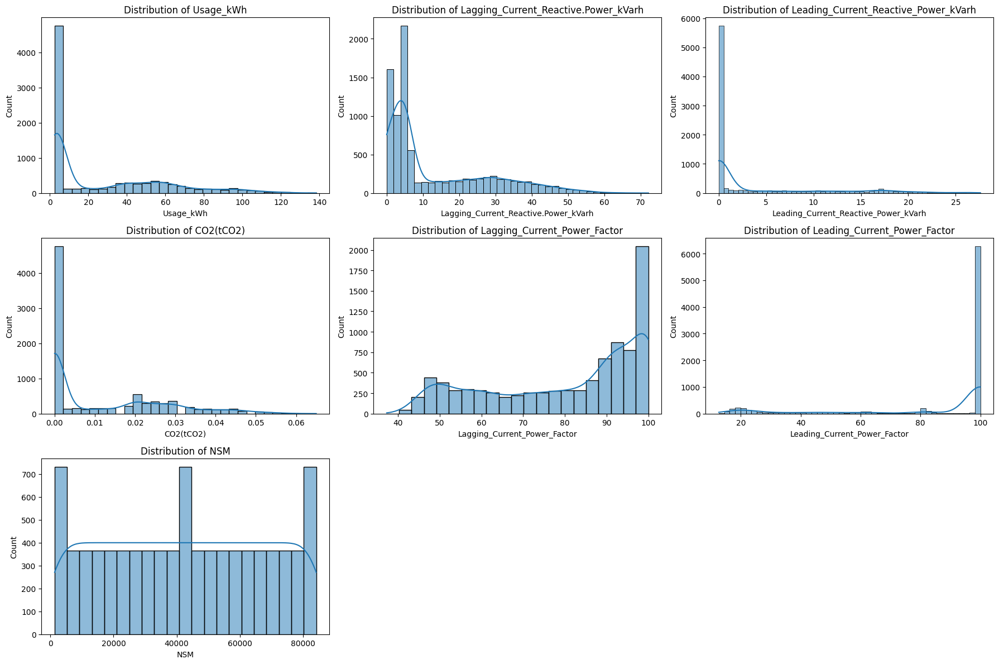

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

numeric_cols = ['Usage_kWh', 'Lagging_Current_Reactive.Power_kVarh',
       'Leading_Current_Reactive_Power_kVarh', 'CO2(tCO2)',
       'Lagging_Current_Power_Factor', 'Leading_Current_Power_Factor', 'NSM']

# 3 plots per row
n_cols = 3
n_rows = (len(numeric_cols) + n_cols - 1) // n_cols  # ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(df[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Turn off unused axes
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


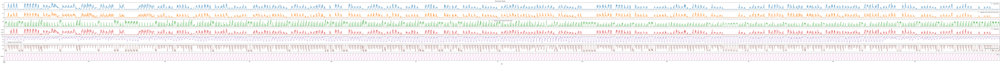

In [12]:
df[numeric_cols].plot(subplots=True, figsize=(150, 10), title="Time-Series Trends")
plt.tight_layout()
plt.show()


In [13]:
log_df=df.copy()
numeric_cols_log = ['Usage_kWh', 'Lagging_Current_Reactive.Power_kVarh',
       'Leading_Current_Reactive_Power_kVarh', 'CO2(tCO2)',
       'Lagging_Current_Power_Factor', 'Leading_Current_Power_Factor']

# Apply log1p to each column and add new columns with `_log` suffix
for col in numeric_cols_log:
    log_df[col] = np.log1p(df[col])

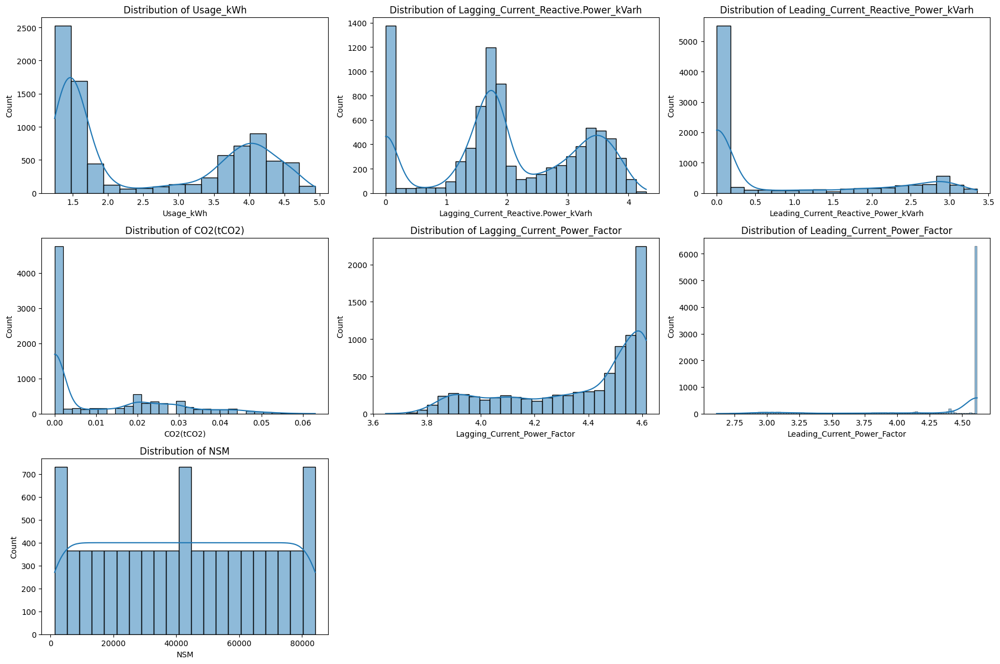

In [14]:
n_cols = 3
n_rows = (len(numeric_cols) + n_cols - 1) // n_cols  # ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(log_df[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Turn off unused axes
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

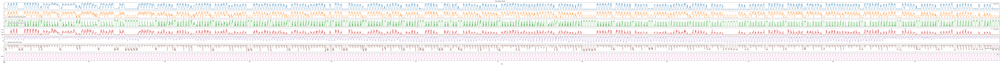

In [15]:
log_df[numeric_cols].plot(subplots=True, figsize=(150, 10), title="Time-Series Trends")
plt.tight_layout()
plt.show()


LOG

In [16]:
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(log_df)

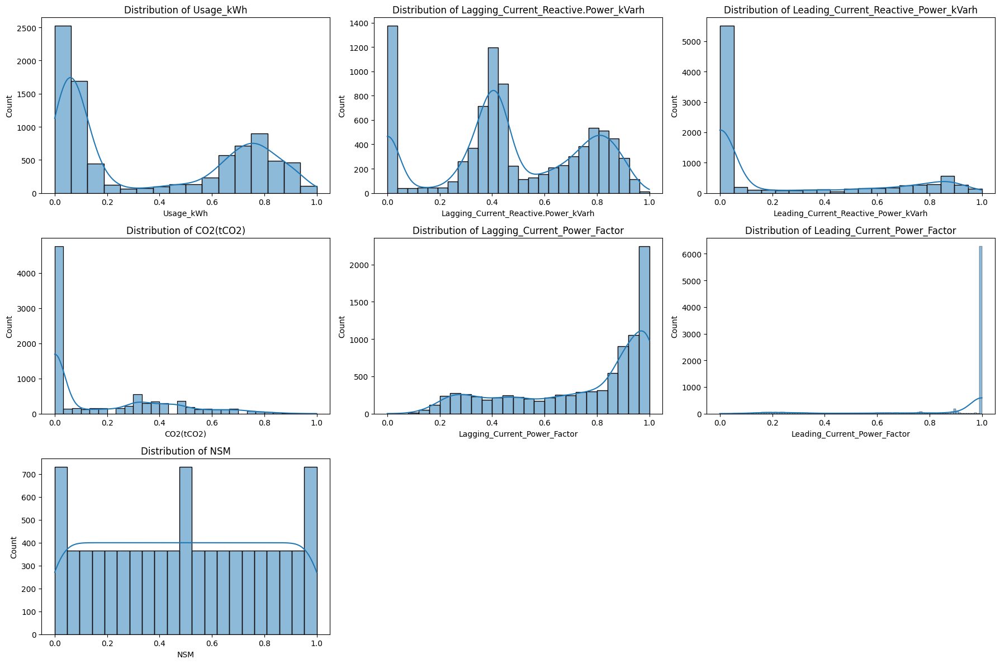

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

numeric_cols = ['Usage_kWh', 'Lagging_Current_Reactive.Power_kVarh',
       'Leading_Current_Reactive_Power_kVarh', 'CO2(tCO2)',
       'Lagging_Current_Power_Factor', 'Leading_Current_Power_Factor', 'NSM']

# Convert scaled_data back to DataFrame for plotting with column names
scaled_df = pd.DataFrame(scaled_data, columns=df.columns)

# 3 plots per row
n_cols = 3
n_rows = (len(numeric_cols) + n_cols - 1) // n_cols  # ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(scaled_df[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Turn off unused axes
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Correlation Heatmap

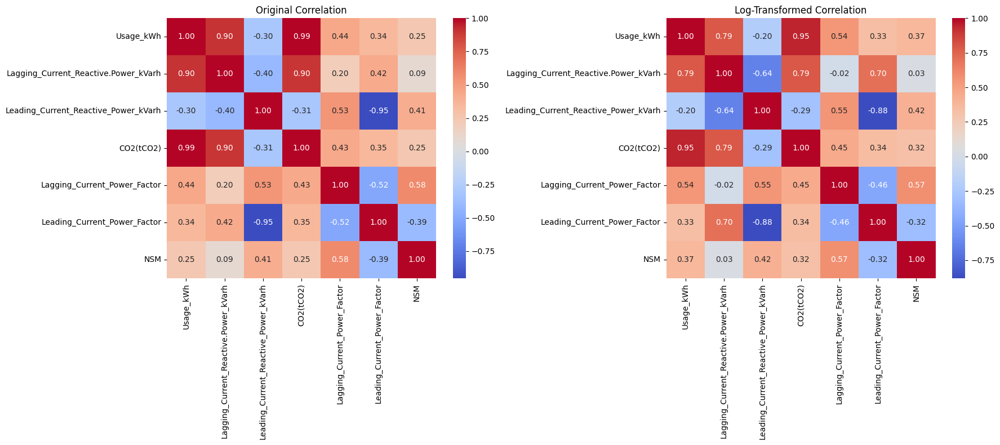

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a log-transformed DataFrame
log_df = df[numeric_cols].apply(np.log1p)

# Set up side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# Original correlation heatmap
sns.heatmap(df[numeric_cols].corr(), annot=True, cmap='coolwarm', fmt='.2f', ax=axes[0])
axes[0].set_title('Original Correlation')

# Log-transformed correlation heatmap
sns.heatmap(log_df.corr(), annot=True, cmap='coolwarm', fmt='.2f', ax=axes[1])
axes[1].set_title('Log-Transformed Correlation')


plt.tight_layout()
plt.show()


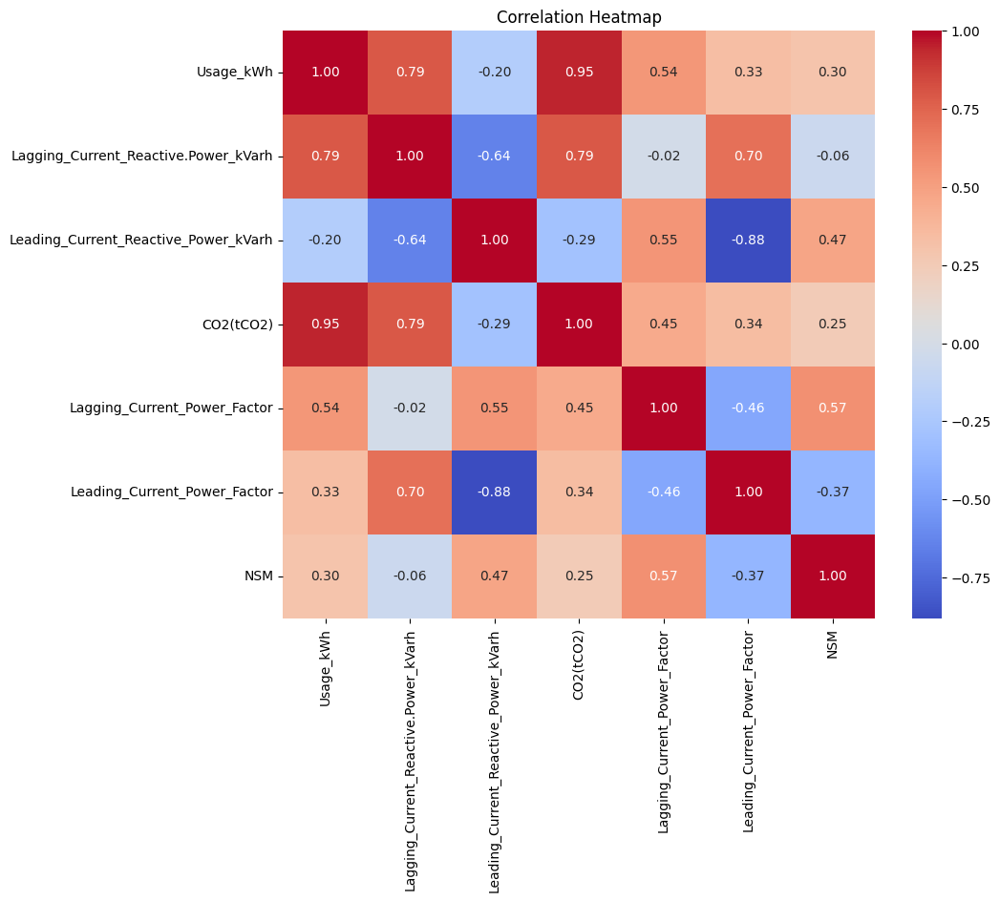

In [19]:
plt.figure(figsize=(10, 8))
sns.heatmap(scaled_df[numeric_cols].corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.show()


Categorical Feature Distributions

In [20]:
df[df['Load_Type']==0].shape, df[df['Load_Type']==1].shape,df[df['Load_Type']==2].shape

((4518, 9), (1818, 9), (2424, 9))

In [21]:
df[df['WeekStatus']==0].shape, df[df['WeekStatus']==1].shape

((6264, 9), (2496, 9))

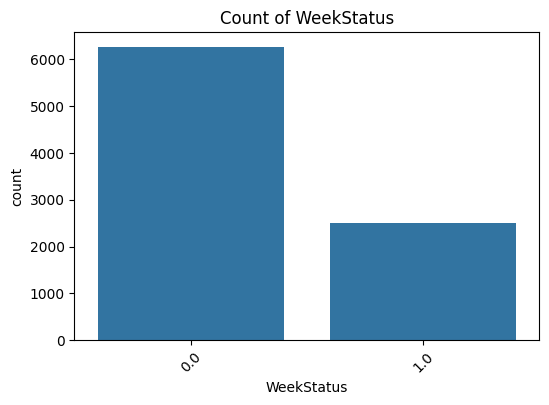

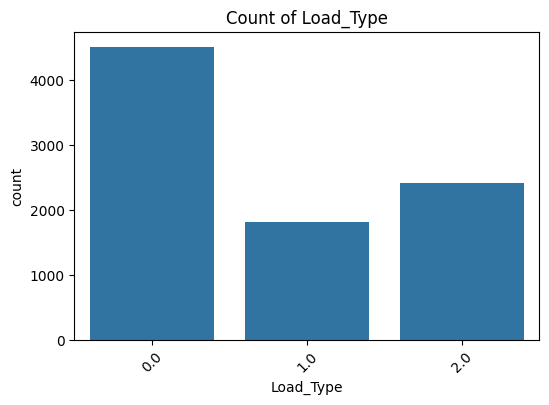

In [22]:
categorical_cols = ['WeekStatus', 'Load_Type']

for col in categorical_cols:
    plt.figure(figsize=(6, 4))
    sns.countplot(x=col, data=df)
    plt.title(f'Count of {col}')
    plt.xticks(rotation=45)
    plt.show()


In [23]:
scaled_df.shape

(8760, 9)

In [100]:
scaled_df.head()

,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Load_Type
0,0.068186,0.352315,0.0,0.0,0.638592,1.0,0.000000,0.0,0.0
1,0.070905,0.372114,0.0,0.0,0.585156,1.0,0.314331,0.0,0.0
2,0.072554,0.382602,0.0,0.0,0.557186,1.0,0.446589,0.0,0.0
3,0.068034,0.377244,0.0,0.0,0.562310,1.0,0.531629,0.0,0.0
4,0.077733,0.393285,0.0,0.0,0.537829,1.0,0.594433,0.0,0.0


In [20]:
import numpy as np

numeric_cols = ['Usage_kWh', 'Lagging_Current_Reactive.Power_kVarh',
       'Leading_Current_Reactive_Power_kVarh', 'CO2(tCO2)',
       'Lagging_Current_Power_Factor', 'Leading_Current_Power_Factor', 'NSM']

# Apply log1p to each column and add new columns with `_log` suffix
for col in numeric_cols:
    scaled_df[col] = np.log1p(scaled_df[col])


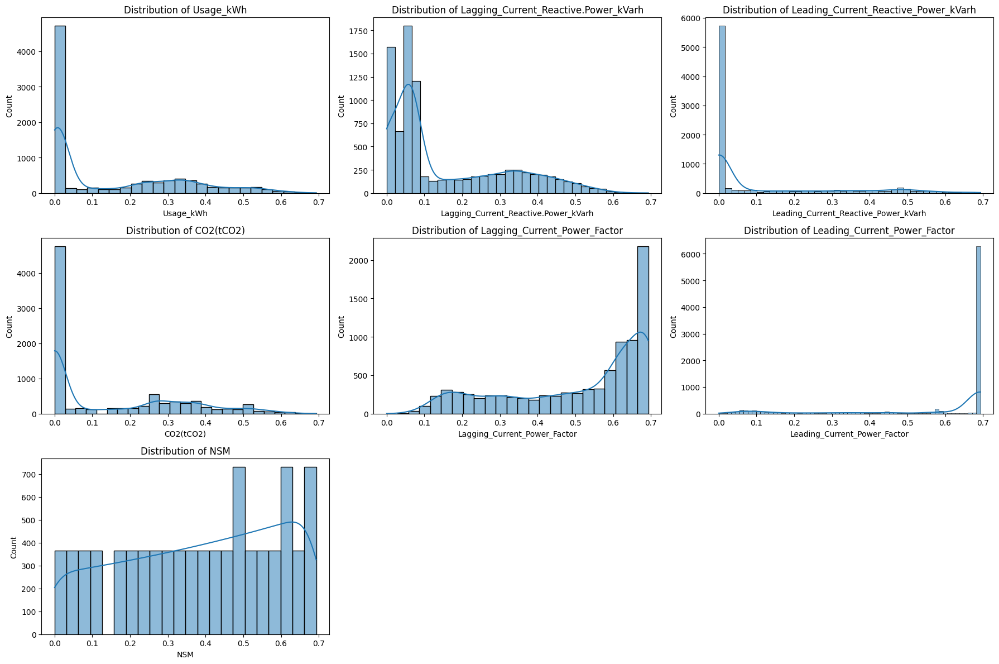

In [21]:
# 3 plots per row
n_cols = 3
n_rows = (len(numeric_cols) + n_cols - 1) // n_cols  # ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(scaled_df[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Turn off unused axes
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:

# Sliding window transformation
def create_sliding_windows(data, window_size=1):
    X, y = [], []
    for i in range(len(data)-window_size):
        X.append(data[i:i+window_size, 1:])
        y.append(data[i+window_size, 0])
    return np.array(X), np.array(y)


In [ ]:
data={}

In [ ]:
window_sizes=[1,4,8,12,16,24,36,48,74,168,336,672]

In [ ]:
for window in window_sizes:
  X, y = create_sliding_windows(scaled_data, window)
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.18, shuffle=False)
  data[f"win{window}"] = {
      "X_train": X_train,
      "X_test": X_test,
      "y_train": y_train,
      "y_test": y_test
  }


In [ ]:
# pip install tensorflow

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Bidirectional, Dense, Dropout

In [ ]:
def build_lstm_model(model_type, input_shape):
    model = Sequential()

    if model_type == 'single':
        model.add(LSTM(64, input_shape=input_shape))
    elif model_type == 'double':
        model.add(LSTM(64, return_sequences=True, input_shape=input_shape))
        model.add(LSTM(64))
    elif model_type == 'bidirectional':
        model.add(Bidirectional(LSTM(64), input_shape=input_shape))

    model.add(Dropout(0.1))
    model.add(Dense(1))
    return model

Single layer

In [ ]:
import tensorflow.keras.backend as K
def rmse(y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_true - y_pred)))


In [ ]:
single_models={}

In [ ]:
for window_size in window_sizes:
  X_train=data[f"win{window_size}"]["X_train"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_train=data[f"win{window_size}"]["y_train"]
  y_test=data[f"win{window_size}"]["y_test"]

  print("==> Windows ",window_size)
  print("-->",X_train.shape,y_train.shape,X_test.shape)

  model = build_lstm_model('single', (window_size, X_train.shape[2]))
  model.compile(optimizer='adam', loss=rmse, metrics=['mae'])
  history = model.fit(
      X_train, y_train,
      epochs=50,
      batch_size=32,
      validation_split=0.2,
      verbose=1
  )
  single_models[f"win{window_size}"]={
      "model":model,
      "history":history
  }


==> Windows  1
--> (7182, 1, 8) (7182,) (1577, 1, 8)
Epoch 1/2


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


180/180 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.1854 - mae: 0.1440 - val_loss: 0.1173 - val_mae: 0.0766
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1392 - mae: 0.0941 - val_loss: 0.1203 - val_mae: 0.0806
==> Windows  4
--> (7179, 4, 8) (7179,) (1577, 4, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.1835 - mae: 0.1435 - val_loss: 0.1199 - val_mae: 0.0852
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.1398 - mae: 0.1009 - val_loss: 0.1096 - val_mae: 0.0827
==> Windows  8
--> (7176, 8, 8) (7176,) (1576, 8, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.1927 - mae: 0.1489 - val_loss: 0.1162 - val_mae: 0.0846
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.1352 - mae: 0.0952 - val_loss: 0.1078 - val_mae: 0.0782
==> Windows  12
--> (7173, 12, 8) (7173,) (1575, 12, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.1821 - mae: 0.1426 - val_loss: 0.1238 - val_mae: 0.0866
Epoch 2/2
180/180 ━━━━━━━━━

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


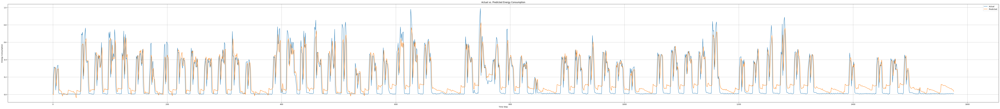

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


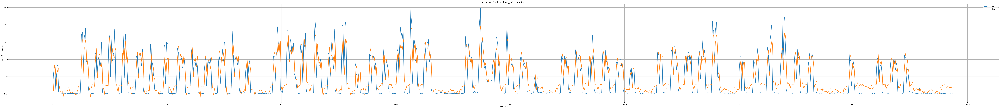

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


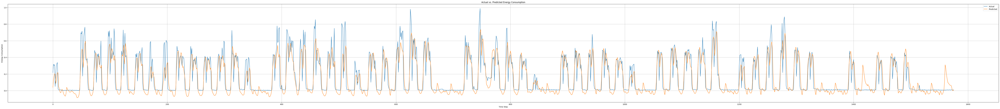

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


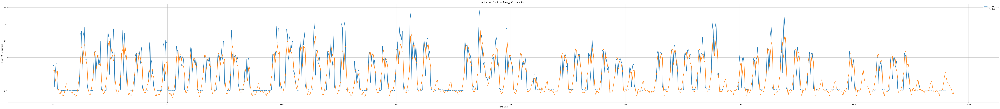

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


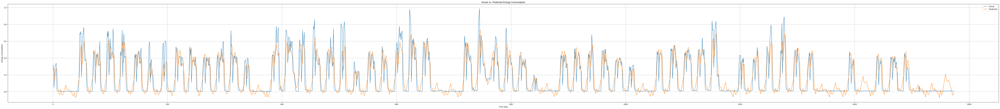

In [ ]:
for window_size in window_sizes:
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  predict=single_models[f"win{window_size}"]["model"].predict(X_test)

  r = range(0, len(y_test))
  plt.figure(figsize=(100, 10))
  plt.plot(r, y_test, label='Actual' )
  plt.plot(r, predict, label='Predicted')

  plt.legend()
  plt.title('Actual vs. Predicted Energy Consumption')
  plt.xlabel('Time Step')
  plt.ylabel('Energy Consumption')
  plt.grid(True)
  plt.show()

Double

In [ ]:
dou_models={}

In [ ]:
for window_size in window_sizes:
  X_train=data[f"win{window_size}"]["X_train"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_train=data[f"win{window_size}"]["y_train"]
  y_test=data[f"win{window_size}"]["y_test"]

  print("==> Windows ",window_size)
  print("-->",X_train.shape,y_train.shape,X_test.shape)
  model = build_lstm_model('double', (window_size, X_train.shape[2]))
  model.compile(optimizer='adam', loss=rmse , metrics=['mae'])
  history = model.fit(
      X_train, y_train,
      epochs=50,
      batch_size=32,
      validation_split=0.2,
      verbose=1
  )
  dou_models[f"win{window_size}"]={
      "model":model,
      "history":history
  }

==> Windows  1
--> (7182, 1, 8) (7182,) (1577, 1, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.2069 - mae: 0.1574 - val_loss: 0.1169 - val_mae: 0.0779
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.1339 - mae: 0.0904 - val_loss: 0.1153 - val_mae: 0.0742
==> Windows  4
--> (7179, 4, 8) (7179,) (1577, 4, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 12ms/step - loss: 0.1980 - mae: 0.1545 - val_loss: 0.1253 - val_mae: 0.0943
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - loss: 0.1384 - mae: 0.0995 - val_loss: 0.0947 - val_mae: 0.0628
==> Windows  8
--> (7176, 8, 8) (7176,) (1576, 8, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.1766 - mae: 0.1388 - val_loss: 0.1200 - val_mae: 0.0864
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 0.1360 - mae: 0.0949 - val_loss: 0.1150 - val_mae: 0.0821
==> Windows  12
--> (7173, 12, 8) (7173,) (1575, 12, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 11s 29ms/step - loss: 0.1899 - mae: 0.14

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


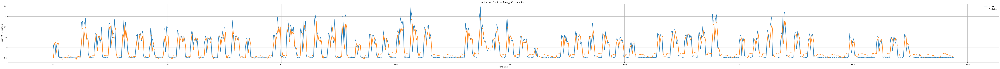

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


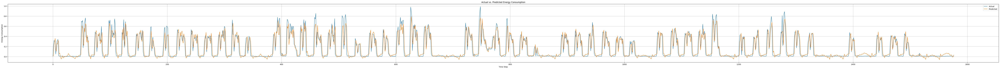

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


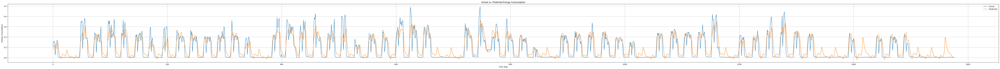

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step


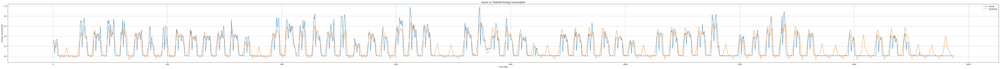

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


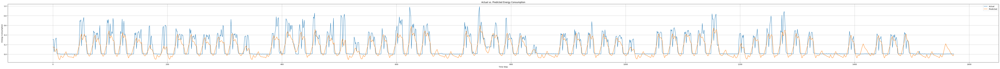

In [ ]:
for window_size in window_sizes:
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  predict=dou_models[f"win{window_size}"]["model"].predict(X_test)

  r = range(0, len(y_test))
  plt.figure(figsize=(100, 10))
  plt.plot(r, y_test, label='Actual' )
  plt.plot(r, predict, label='Predicted')

  plt.legend()
  plt.title('Actual vs. Predicted Energy Consumption')
  plt.xlabel('Time Step')
  plt.ylabel('Energy Consumption')
  plt.grid(True)
  plt.show()

Bidirectional

In [ ]:
bidirec_models={}

In [ ]:
for window_size in window_sizes:
  X_train=data[f"win{window_size}"]["X_train"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_train=data[f"win{window_size}"]["y_train"]
  y_test=data[f"win{window_size}"]["y_test"]

  print("==> Windows ",window_size)
  print("-->",X_train.shape,y_train.shape,X_test.shape)

  model = build_lstm_model('bidirectional', (window_size, X_train.shape[2]))
  model.compile(optimizer='adam', loss=rmse, metrics=['mae'])
  history = model.fit(
      X_train, y_train,
      epochs=50,
      batch_size=32,
      validation_split=0.2,
      verbose=1
  )
  bidirec_models[f"win{window_size}"]={
      "model":model,
      "history":history
  }

==> Windows  1
--> (7182, 1, 8) (7182,) (1577, 1, 8)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/bidirectional.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.1888 - mae: 0.1466 - val_loss: 0.1196 - val_mae: 0.0792
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.1355 - mae: 0.0915 - val_loss: 0.1177 - val_mae: 0.0758
==> Windows  4
--> (7179, 4, 8) (7179,) (1577, 4, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.1831 - mae: 0.1419 - val_loss: 0.1185 - val_mae: 0.0842
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.1352 - mae: 0.0975 - val_loss: 0.1106 - val_mae: 0.0840
==> Windows  8
--> (7176, 8, 8) (7176,) (1576, 8, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 7s 16ms/step - loss: 0.1962 - mae: 0.1551 - val_loss: 0.1248 - val_mae: 0.0893
Epoch 2/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.1343 - mae: 0.0977 - val_loss: 0.1053 - val_mae: 0.0741
==> Windows  12
--> (7173, 12, 8) (7173,) (1575, 12, 8)
Epoch 1/2
180/180 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.1714 - mae: 0.1334 - val_loss: 0.1221 - val_mae: 0.0934
Epoch 2/2
180/180

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


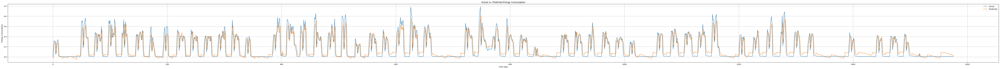

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


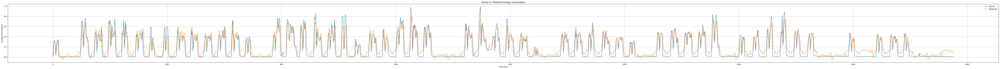

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


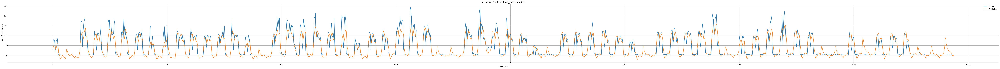

50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step


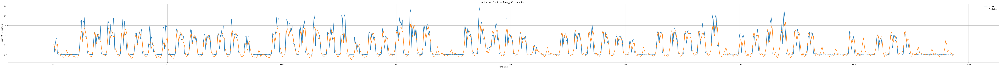

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step


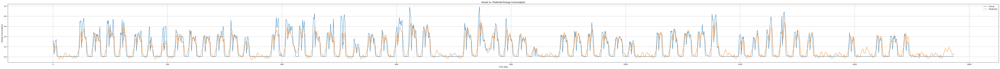

In [ ]:
for window_size in window_sizes:
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  predict=bidirec_models[f"win{window_size}"]["model"].predict(X_test)

  r = range(0, len(y_test))
  plt.figure(figsize=(100, 10))
  plt.plot(r, y_test, label='Actual' )  # Plot actual values
  plt.plot(r, predict, label='Predicted')  # Plot predicted values

  plt.legend()
  plt.title('Actual vs. Predicted Energy Consumption')
  plt.xlabel('Time Step')
  plt.ylabel('Energy Consumption')
  plt.grid(True)  # Optional: Add grid lines
  plt.show()

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, root_mean_squared_error

In [ ]:
# def willmott_index(y_true, y_pred):
#     numerator = np.sum((y_pred - y_true)**2)
#     denominator = np.sum((np.abs(y_pred - np.mean(y_true)) +
#                         np.abs(y_true - np.mean(y_true)))**2)
#     return 1 - (numerator / denominator)

In [ ]:
def evaluate_model(model, X_test, y_test):

	# Predict on test data
	y_pred = model.predict(X_test)

	# Calculate metrics
	rmse = root_mean_squared_error(y_test, y_pred)
	mae = mean_absolute_error(y_test, y_pred)
	r2 = r2_score(y_test, y_pred)

	return {"RMSE": rmse, "MAE": mae, "R2": r2}
metrics = evaluate_model(model, X_test, y_test)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


# Testing

Single layer eve

In [ ]:
for window_size in window_sizes:
  model=single_models[f"win{window_size}"]["model"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  metrics = evaluate_model(model, X_test, y_test)
  print(f"Metrics for window size {window_size}: {metrics}")

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Metrics for window size 1: {'RMSE': 0.12953917715402413, 'MAE': 0.09026807194875189, 'R2': 0.6481119097811038}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Metrics for window size 4: {'RMSE': 0.1176586791931411, 'MAE': 0.08644206442174363, 'R2': 0.7096978597099759}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Metrics for window size 8: {'RMSE': 0.11597571051331085, 'MAE': 0.07571570475905359, 'R2': 0.7180243423329599}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Metrics for window size 12: {'RMSE': 0.12063662684866432, 'MAE': 0.08068693987739559, 'R2': 0.695087829913045}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Metrics for window size 16: {'RMSE': 0.12237152964407136, 'MAE': 0.08000957157122503, 'R2': 0.6863603029920862}


In [ ]:
for window_size in window_sizes:
  model=dou_models[f"win{window_size}"]["model"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  metrics = evaluate_model(model, X_test, y_test)
  print(f"Metrics for window size {window_size}: {metrics}")

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Metrics for window size 1: {'RMSE': 0.12619723987087672, 'MAE': 0.0833183508420858, 'R2': 0.6660341862214498}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Metrics for window size 4: {'RMSE': 0.10353682510114037, 'MAE': 0.06323843313682051, 'R2': 0.7752022360354449}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Metrics for window size 8: {'RMSE': 0.12774748995641597, 'MAE': 0.08682243261042401, 'R2': 0.657876988762141}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Metrics for window size 12: {'RMSE': 0.130873010396477, 'MAE': 0.08954947846871147, 'R2': 0.6411470068012914}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Metrics for window size 16: {'RMSE': 0.13921816611598956, 'MAE': 0.09833822109640733, 'R2': 0.5940597962520885}


In [ ]:
for window_size in window_sizes:
  model=bidirec_models[f"win{window_size}"]["model"]
  X_test=data[f"win{window_size}"]["X_test"]
  y_test=data[f"win{window_size}"]["y_test"]
  metrics = evaluate_model(model, X_test, y_test)
  print(f"Metrics for window size {window_size}: {metrics}")

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Metrics for window size 1: {'RMSE': 0.12697085575856298, 'MAE': 0.08311483812742715, 'R2': 0.6619270731902986}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Metrics for window size 4: {'RMSE': 0.11840306621611565, 'MAE': 0.08634077750420897, 'R2': 0.7060129512176718}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Metrics for window size 8: {'RMSE': 0.11649356489417456, 'MAE': 0.07566057722281479, 'R2': 0.7155005666527341}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Metrics for window size 12: {'RMSE': 0.11475933050287732, 'MAE': 0.0772504675070387, 'R2': 0.7240741429286173}
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Metrics for window size 16: {'RMSE': 0.12272511300534192, 'MAE': 0.08185692428934178, 'R2': 0.6845452076994573}


# XAI

In [ ]:
!pip install shap


In [ ]:
### 5. XAI with SHAP
import shap

In [ ]:
# Sample background data for SHAP
background = X_train[np.random.choice(X_train.shape[0], 100, replace=False)]

In [ ]:
!pip install tf_keras

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [ ]:
# 1. Fix SHAP explanation with proper input handling
def explain_model(model, X_train, X_test):
    # Create background samples with explicit RNG
    rng = np.random.default_rng(42)
    background_samples = X_train[rng.choice(X_train.shape[0], 50, replace=False)]

    # Ensure model is in inference mode
    model.trainable = False

    # Use KernelExplainer for better LSTM compatibility
    explainer = shap.KernelExplainer(
        model.predict,
        background_samples,
        rng=rng
    )

    # Calculate SHAP values with proper input reshaping
    return explainer.shap_values(X_test[:200], nsamples=100)

In [ ]:
model=single_models['win12']['model']
X_test=data['win12']['X_test']
y_test=data['win12']['y_test']
X_train=data['win12']['X_train']

In [ ]:
X_test.shape, y_test.shape, X_train.shape

((1575, 12, 8), (1575,), (7173, 12, 8))

In [ ]:
rx=X_test.reshape(-1,9)
ry=y_test.reshape(-1)
rxt=X_train.reshape(-1,9)

In [ ]:
rx.shape, ry.shape

((16800, 9), (1575,))

In [ ]:
class LSTMWrapper:
    def __init__(self, model, time_steps, feature_names):
        self.model = model
        self.time_steps = time_steps
        self.feature_names = feature_names

    def predict(self, X):
        # For SHAP analysis, we'll focus on the last time step only
        # Shape X from (num_samples, features) to (num_samples, time_steps, features)
        # by repeating the same values for all time steps
        samples = X.shape[0]
        reshaped_X = np.zeros((samples, self.time_steps, X.shape[1]))

        # Copy the same sample across all time steps (we'll analyze feature importance
        # by varying values at a consistent state)
        for i in range(samples):
            reshaped_X[i, :, :] = np.tile(X[i, :], (self.time_steps, 1))

        return self.model.predict(reshaped_X, verbose=0).flatten()

In [ ]:
background_data = X_test[:100, -1, :]

In [ ]:
background_data.shape

(100, 8)

In [ ]:
feature_names =fet.drop('Usage_kWh')


In [ ]:

feature_names = list(feature_names)


In [ ]:
feature_names

['Lagging_Current_Reactive.Power_kVarh',
 'Leading_Current_Reactive_Power_kVarh',
 'CO2(tCO2)',
 'Lagging_Current_Power_Factor',
 'Leading_Current_Power_Factor',
 'NSM',
 'WeekStatus',
 'Load_Type']

In [ ]:
type(feature_names)

list

In [ ]:
model_wrapper = LSTMWrapper(model, 12, feature_names)

In [ ]:
explainer = shap.KernelExplainer(model_wrapper.predict, background_data)


In [ ]:
X_to_explain = X_test[:200, -1, :]  # Using last time step of each sequence


In [ ]:
# Calculate SHAP values
shap_values = explainer.shap_values(X_to_explain)


  0%|          | 0/200 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
feature_names

In [ ]:
plt.figure(figsize=(10, 8))
shap.summary_plot(
    shap_values,
    X_to_explain,
    feature_names=feature_names,
    plot_type="violin",
    show=False
)
plt.tight_layout()
plt.savefig("lstm_shap_summary_plot.png")
plt.show()
plt.close()

In [ ]:
shap.summary_plot(
    shap_values,
    X_to_explain,
    feature_names=feature_names,
    plot_type="bar",
    show=False
)
plt.tight_layout()
plt.savefig("lstm_shap_bar_plot.png")
plt.show()
plt.close()